In [1]:
from mmdet.apis import init_detector, inference_detector, show_result_pyplot
import mmcv

from sahi.model import MmdetDetectionModel
from sahi.predict import get_prediction, get_sliced_prediction, predict
from IPython.display import Image

In [3]:
config_file2= 'config/mask_rcnn_r50_fpn_GN_1x1_10e_coco.py'
config_file3= 'config/cascade_mask_rcnn_r101_GN_1x1_1x_coco.py'
model_path = '/mnt/e/afterFIT_intern/PPDETECT/epoch_100scratch.pth'
model_path2 = '/mnt/e/afterFIT_intern/PPDETECT/epoch_100.pth'
model_path3 = '/mnt/e/afterFIT_intern/PPDETECT/epoch_100cascademask.pth'

In [4]:
from mmdet.apis import set_random_seed
from mmcv import Config

# the new config inherits the base configs to highlight the necessary modification
cfg = Config.fromfile('../configs/scratch/mask_rcnn_r50_fpn_gn-all_scratch_6x_coco.py')

data_root = '/kaggle/input/solar-panel-module/crop/' 
# Modify dataset type and path
cfg.dataset_type = 'CocoDataset'
cfg.classes = ('module',)
cfg.data_root = '../data/'

cfg.data.test.type = 'CocoDataset'
cfg.data.test.classes = ('module',)
cfg.data.test.data_root = '../data/train2/'
cfg.data.test.ann_file = 'via_project_25Mar2021_20h43m_coco.json'

cfg.data.train.type = 'CocoDataset'
cfg.data.train.classes = ('module',)
cfg.data.train.data_root = '../data/train2/'
cfg.data.train.ann_file = 'via_project_25Mar2021_20h43m_coco.json'

cfg.data.val.type = 'CocoDataset'
cfg.data.val.classes = ('module',)
cfg.data.val.data_root = '../data/train2/'
cfg.data.val.ann_file = 'via_project_25Mar2021_20h43m_coco.json'

# modify num classes of the model in box head
cfg.model.roi_head.bbox_head.num_classes = 1
cfg.model.roi_head.mask_head.num_classes = 1

cfg.optimizer.lr = 0.02 / 8
cfg.optimizer_config.grad_clip = dict(max_norm=35, norm_type=2)

cfg.lr_config.policy = 'step'
cfg.lr_config.step = 10

cfg.data.samples_per_gpu = 1
cfg.data.workers_per_gpu = 1

cfg.evaluation.metric = 'bbox'
cfg.evaluation.interval = 20

cfg.checkpoint_config.interval = 20

cfg.runner.max_epochs = 100

cfg.log_config.interval = 100

cfg.seed = 0
set_random_seed(0, deterministic=False)
cfg.gpu_ids = range(1)


# We can initialize the logger for training and have a look
# at the final config used for training
print(f'Config:\n{cfg.pretty_text}')

Config:
model = dict(
    type='MaskRCNN',
    backbone=dict(
        type='ResNet',
        depth=50,
        num_stages=4,
        out_indices=(0, 1, 2, 3),
        frozen_stages=-1,
        norm_cfg=dict(type='GN', requires_grad=True, num_groups=32),
        norm_eval=True,
        style='pytorch',
        init_cfg=None,
        zero_init_residual=False),
    neck=dict(
        type='FPN',
        in_channels=[256, 512, 1024, 2048],
        out_channels=256,
        num_outs=5,
        norm_cfg=dict(type='GN', num_groups=32, requires_grad=True)),
    rpn_head=dict(
        type='RPNHead',
        in_channels=256,
        feat_channels=256,
        anchor_generator=dict(
            type='AnchorGenerator',
            scales=[8],
            ratios=[0.5, 1.0, 2.0],
            strides=[4, 8, 16, 32, 64]),
        bbox_coder=dict(
            type='DeltaXYWHBBoxCoder',
            target_means=[0.0, 0.0, 0.0, 0.0],
            target_stds=[1.0, 1.0, 1.0, 1.0]),
        loss_cls=dict(


## Model 1

Use load_from_local loader


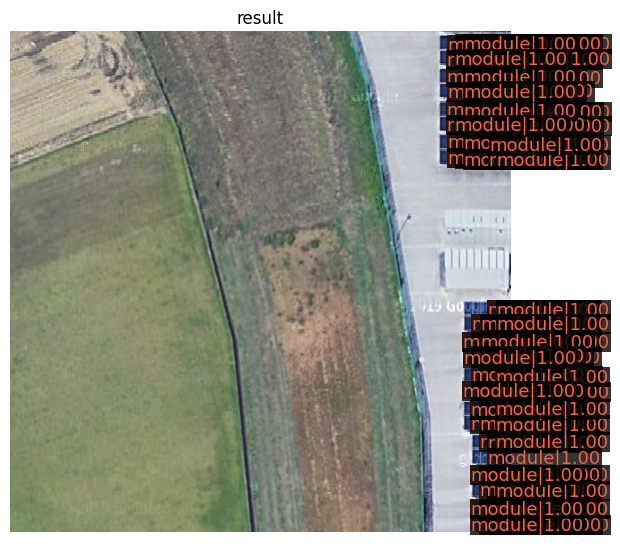

In [14]:
# build the model from a config file and a checkpoint file
model = init_detector(cfg, model_path, device='cpu')
# test a single image
img = '/mnt/e/afterFIT_intern/PPDETECT/annotation_task/train2/no24b.png'
result = inference_detector(model, img)
# show the results
show_result_pyplot(model, img, result, score_thr=0.4)

In [21]:
detection_model = MmdetDetectionModel(
    model_path=model_path,
    config_path=cfg,
    confidence_threshold=0.4,
    device="cpu", # or 'cuda'
)
img = 'data/val/no4b_03.png'
result = get_prediction(img, detection_model)
result.export_visuals(export_dir="result/")
Image("result/prediction_visual.png")

Use load_from_local loader


IndexError: list index out of range

In [20]:
detection_model = MmdetDetectionModel(
    model_path=model_path,
    config_path=cfg,
    confidence_threshold=0.8,
    device="cpu", # or 'cuda'
)
img = 'data/val/no4b_03.png'
result = get_prediction(img, detection_model)
result.export_visuals(export_dir="result/")
Image("result/prediction_visual.png")

/home/jodistiara/Documents/parkinglot/mmdetection/mmdet/core/anchor/builder.py:17: UserWarning: ``build_anchor_generator`` would be deprecated soon, please use ``build_prior_generator`` 
  '``build_anchor_generator`` would be deprecated soon, please use '


Use load_from_local loader


/home/jodistiara/Documents/parkinglot/mmdetection/mmdet/core/anchor/anchor_generator.py:324: UserWarning: ``grid_anchors`` would be deprecated soon. Please use ``grid_priors`` 
  warnings.warn('``grid_anchors`` would be deprecated soon. '
/home/jodistiara/Documents/parkinglot/mmdetection/mmdet/core/anchor/anchor_generator.py:361: UserWarning: ``single_level_grid_anchors`` would be deprecated soon. Please use ``single_level_grid_priors`` 
  '``single_level_grid_anchors`` would be deprecated soon. '


IndexError: list index out of range

In [14]:
# build the model from a config file and a checkpoint file
model = init_detector(config_file2, model_path, device='cpu')
# test a single image
img = 'data/test/Screenshot 2021-10-06 163117.jpg'
result = inference_detector(model, img)
# show the results
show_result_pyplot(model, img, result, score_thr=0.4)

Use load_from_local loader


KeyError: 'img'

/home/jodistiara/Documents/parkinglot/mmdetection/mmdet/core/anchor/builder.py:17: UserWarning: ``build_anchor_generator`` would be deprecated soon, please use ``build_prior_generator`` 
  '``build_anchor_generator`` would be deprecated soon, please use '


Use load_from_local loader
Number of slices: 55


/home/jodistiara/Documents/parkinglot/mmdetection/mmdet/datasets/utils.py:69: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  'data pipeline in your config file.', UserWarning)
/home/jodistiara/Documents/parkinglot/mmdetection/mmdet/core/anchor/anchor_generator.py:324: UserWarning: ``grid_anchors`` would be deprecated soon. Please use ``grid_priors`` 
  warnings.warn('``grid_anchors`` would be deprecated soon. '
/home/jodistiara/Documents/parkinglot/mmdetection/mmdet/core/anchor/anchor_generator.py:361: UserWarning: ``single_level_grid_anchors`` would be deprecated soon. Please use ``single_level_grid_priors`` 
  '``single_level_grid_anchors`` would be deprecated soon. '


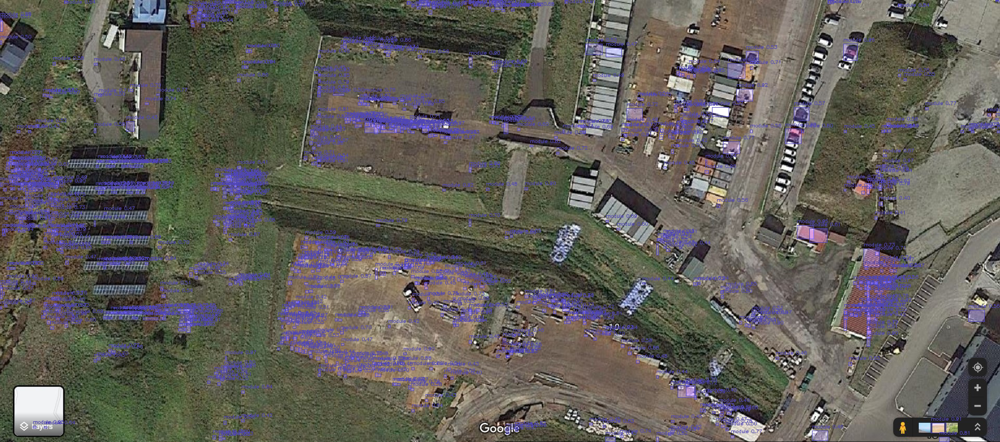

In [6]:
img = 'data/test/Screenshot 2021-10-06 163117.jpg'
detection_model = MmdetDetectionModel(
    model_path=model_path,
    config_path=cfg,
    confidence_threshold=0.4,
    device="cpu", # or 'cuda'
)
result = get_sliced_prediction(
    img,
    detection_model,
    slice_height = 256,
    slice_width = 256,
    overlap_height_ratio = 0.2,
    overlap_width_ratio = 0.2
)
result.export_visuals(export_dir="result/")
Image("result/prediction_visual.png")

Use load_from_local loader
Number of slices: 10


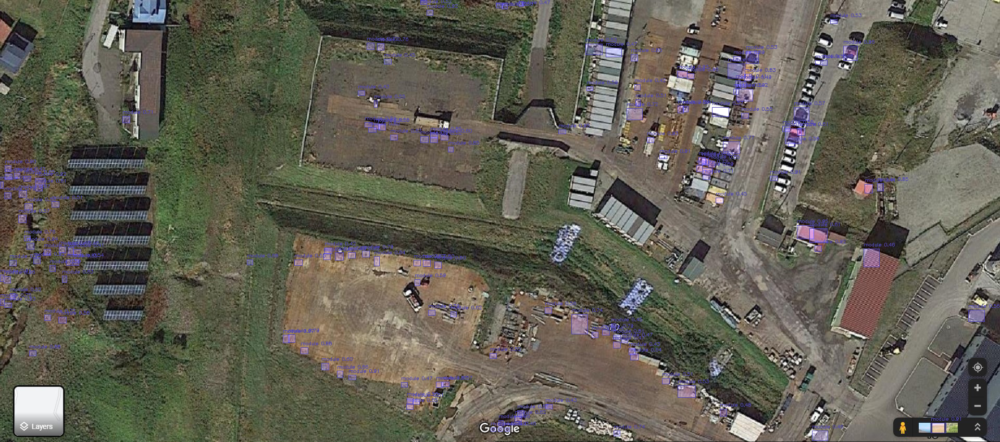

In [15]:
img = 'data/test/Screenshot 2021-10-06 163117.jpg'
detection_model = MmdetDetectionModel(
    model_path=model_path,
    config_path=cfg,
    confidence_threshold=0.4,
    device="cpu", # or 'cuda'
)
result = get_sliced_prediction(
    img,
    detection_model,
    slice_height = 512,
    slice_width = 512,
    overlap_height_ratio = 0.3,
    overlap_width_ratio = 0.3
)
result.export_visuals(export_dir="result/")
Image("result/prediction_visual.png")

In [22]:
img = 'data/test/Screenshot 2021-10-06 163117.jpg'
detection_model = MmdetDetectionModel(
    model_path=model_path,
    config_path=cfg,
    confidence_threshold=0.4,
    device="cpu", # or 'cuda'
)
result = get_sliced_prediction(
    img,
    detection_model,
    slice_height = 128,
    slice_width = 128,
    overlap_height_ratio = 0.3,
    overlap_width_ratio = 0.3
)
result.export_visuals(export_dir="result/")
Image("result/prediction_visual.png")

Use load_from_local loader
Number of slices: 210


/home/jodistiara/anaconda3/envs/openmmlab/lib/python3.7/site-packages/sahi/postprocess/combine.py:97: RuntimeWarning: invalid value encountered in long_scalars
  return intersect / smaller_area


IndexError: list index out of range

## Model 2

Use load_from_local loader


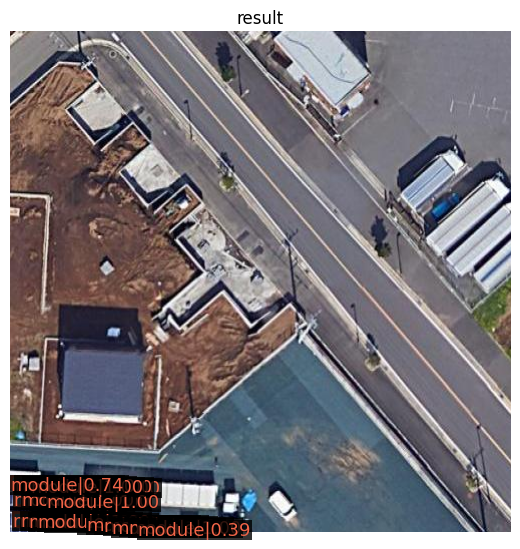

In [6]:
# build the model from a config file and a checkpoint file
model = init_detector(config_file2, model_path2, device='cpu')
# test a single image
img = 'data/train2/no22a.png'
result = inference_detector(model, img)
# show the results
show_result_pyplot(model, img, result)

In [ ]:
img = 'data/val/no4b_03.png'
detection_model = MmdetDetectionModel(
    model_path=model_path2,
    config_path=config_path2,
    confidence_threshold=0.4,
    device="cpu", # or 'cuda'
)
result = get_prediction(img, detection_model)
result.export_visuals(export_dir="result/")
Image("result/prediction_visual.png")

In [ ]:
# build the model from a config file and a checkpoint file
model = init_detector(config_file2, model_path2, device='cpu')
# test a single image
img = 'data/train2/no22a.png'
result = inference_detector(model, img)
# show the results
show_result_pyplot(model, img, result)

Use load_from_local loader


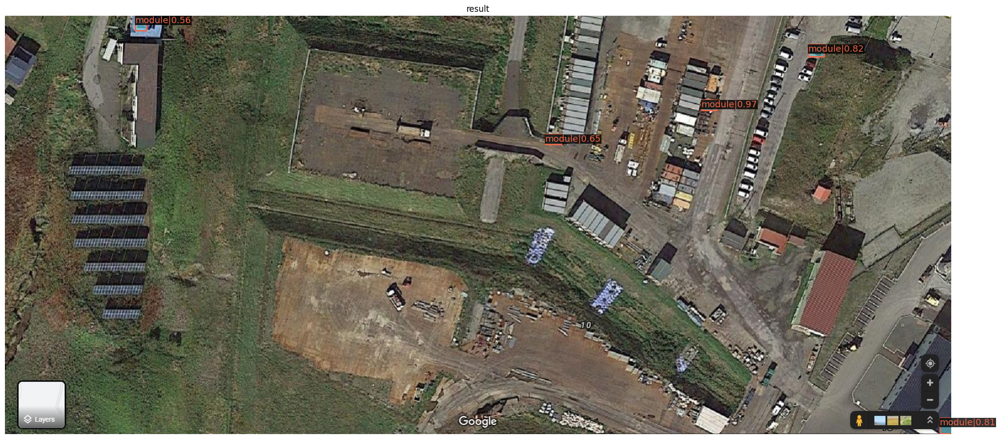

In [13]:
# build the model from a config file and a checkpoint file
model = init_detector(config_file2, model_path2, device='cpu')
# test a single image
img = 'data/test/Screenshot 2021-10-06 163117.jpg'
result = inference_detector(model, img)
# show the results
show_result_pyplot(model, img, result, score_thr=0.1)

Use load_from_local loader
Number of slices: 40


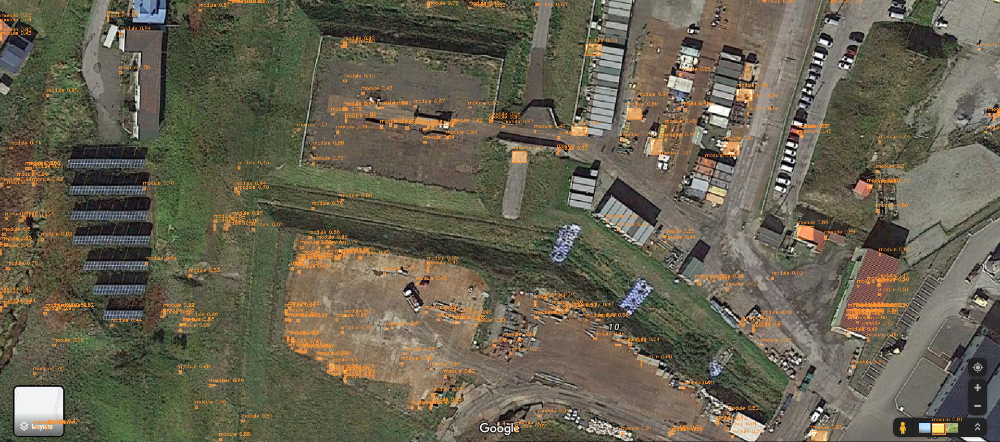

In [18]:
img = 'data/test/Screenshot 2021-10-06 163117.jpg'
detection_model = MmdetDetectionModel(
    model_path=model_path2,
    config_path=config_file2,
    confidence_threshold=0.4,
    device="cpu", # or 'cuda'
)
result = get_sliced_prediction(
    img,
    detection_model,
    slice_height = 256,
    slice_width = 256,
    overlap_height_ratio = 0.2,
    overlap_width_ratio = 0.2
)
result.export_visuals(export_dir="result/")
Image("result/prediction_visual.png")

Use load_from_local loader
Number of slices: 10


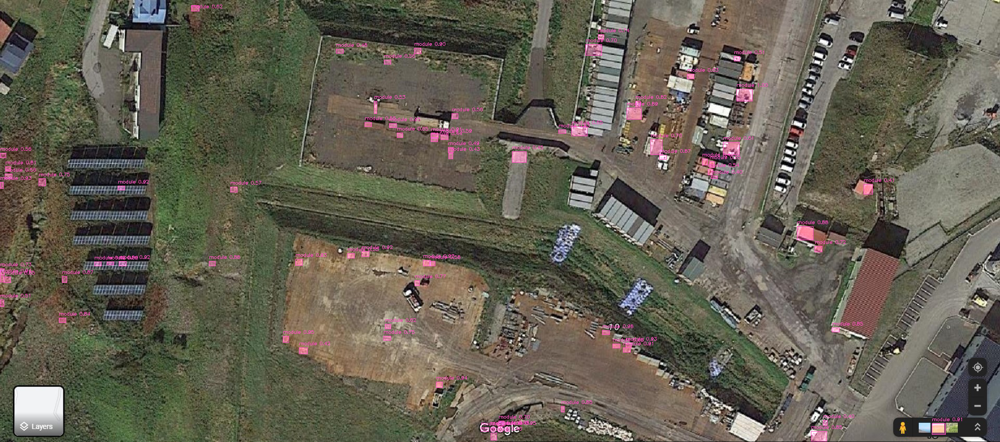

In [19]:
img = 'data/test/Screenshot 2021-10-06 163117.jpg'
detection_model = MmdetDetectionModel(
    model_path=model_path2,
    config_path=config_file2,
    confidence_threshold=0.4,
    device="cpu", # or 'cuda'
)
result = get_sliced_prediction(
    img,
    detection_model,
    slice_height = 512,
    slice_width = 512,
    overlap_height_ratio = 0.3,
    overlap_width_ratio = 0.3
)
result.export_visuals(export_dir="result/")
Image("result/prediction_visual.png")

## Model 3

Use load_from_local loader


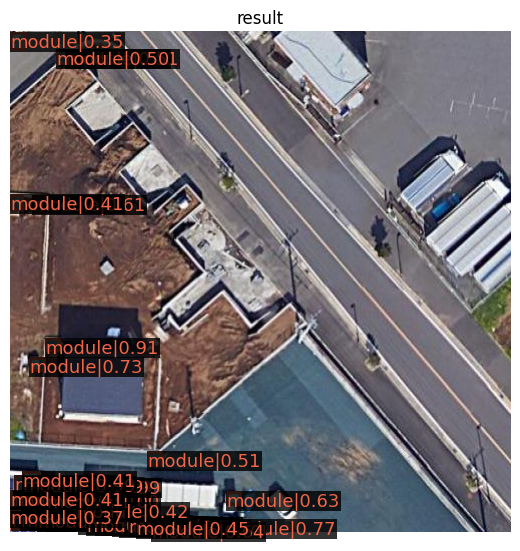

In [6]:
# build the model from a config file and a checkpoint file
model = init_detector(config_file3, model_path3, device='cpu')
# test a single image
img = '/mnt/e/afterFIT_intern/PPDETECT/annotation_task/train2/no22a.png'
result = inference_detector(model, img)
# show the results
show_result_pyplot(model, img, result)

Use load_from_local loader


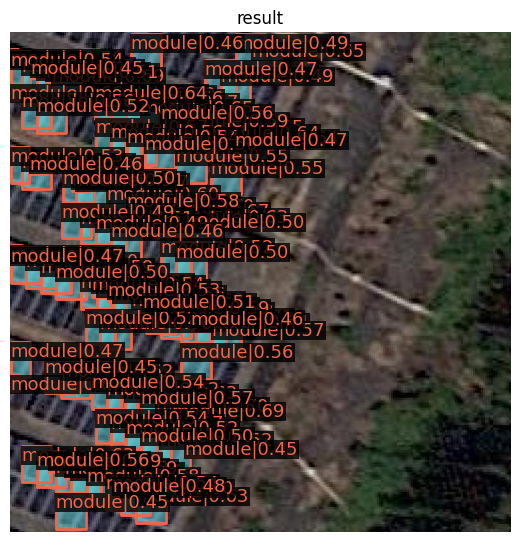

In [7]:
# build the model from a config file and a checkpoint file
model = init_detector(config_file3, model_path3, device='cpu')
# test a single image
img = 'data/val/no4b_03.png'
result = inference_detector(model, img)
# show the results
show_result_pyplot(model, img, result)

Use load_from_local loader
Number of slices: 9


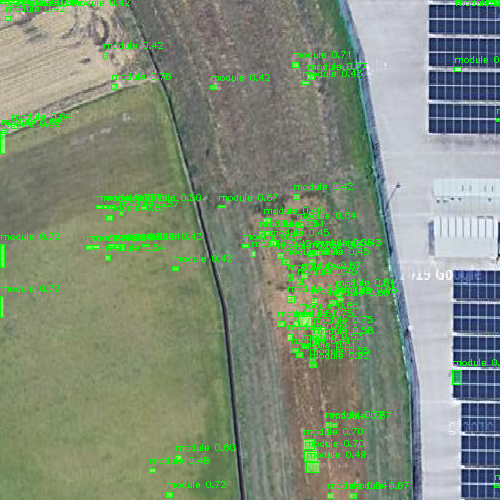

In [22]:
img = 'data/train2/no24b.png'
detection_model = MmdetDetectionModel(
    model_path=model_path,
    config_path=config_file,
    confidence_threshold=0.4,
    device="cpu", # or 'cuda'
)
result = get_sliced_prediction(
    img,
    detection_model,
    slice_height = 256,
    slice_width = 256,
    overlap_height_ratio = 0.2,
    overlap_width_ratio = 0.2
)
result.export_visuals(export_dir="result/")
Image("result/prediction_visual.png")

In [ ]:
img = '/data/train2/no22a.png'
detection_model = MmdetDetectionModel(
    model_path=model_path,
    config_path=config_file,
    confidence_threshold=0.4,
    device="cpu", # or 'cuda'
)
result = get_sliced_prediction(
    img,
    detection_model,
    slice_height = 128,
    slice_width = 128,
    overlap_height_ratio = 0.3,
    overlap_width_ratio = 0.3
)
result.export_visuals(export_dir="result/")
Image("result/prediction_visual.png")

Use load_from_local loader
Number of slices: 36


Use load_from_local loader


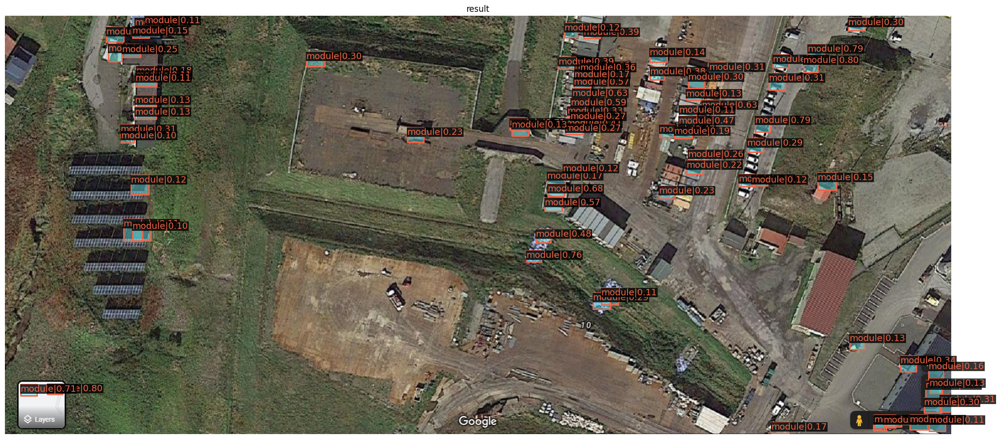

In [15]:
# build the model from a config file and a checkpoint file
model = init_detector(config_file3, model_path3, device='cpu')
# test a single image
img = 'data/test/Screenshot 2021-10-06 163117.jpg'
result = inference_detector(model, img)
# show the results
show_result_pyplot(model, img, result, score_thr=0.1)

Use load_from_local loader
Number of slices: 40


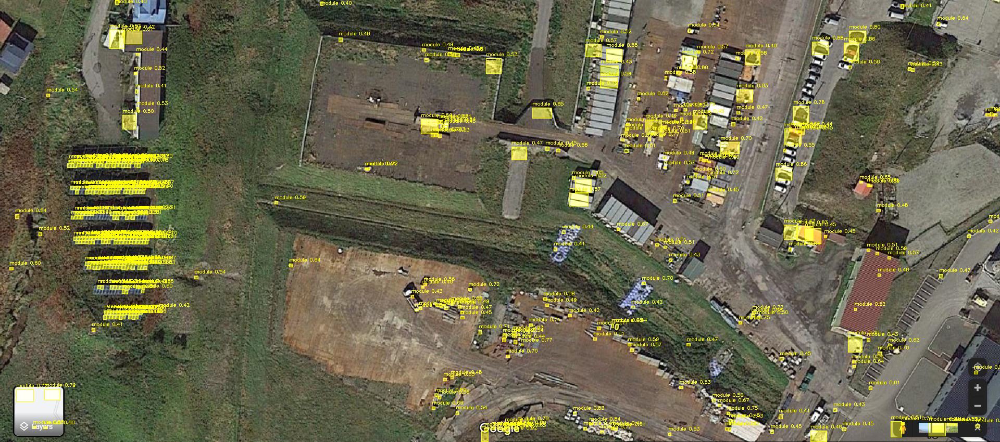

In [17]:
img = 'data/test/Screenshot 2021-10-06 163117.jpg'
detection_model = MmdetDetectionModel(
    model_path=model_path3,
    config_path=config_file3,
    confidence_threshold=0.4,
    device="cpu", # or 'cuda'
)
result = get_sliced_prediction(
    img,
    detection_model,
    slice_height = 256,
    slice_width = 256,
    overlap_height_ratio = 0.2,
    overlap_width_ratio = 0.2
)
result.export_visuals(export_dir="result/")
Image("result/prediction_visual.png")

Use load_from_local loader
Number of slices: 10


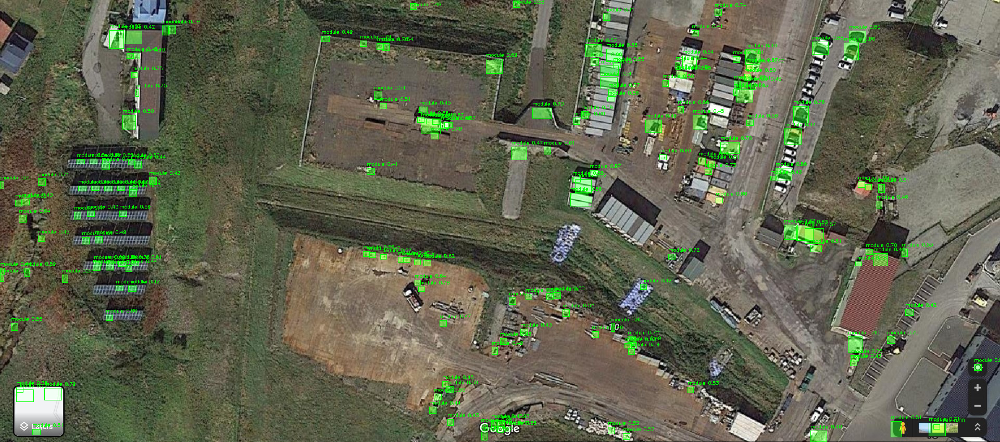

In [16]:
img = 'data/test/Screenshot 2021-10-06 163117.jpg'
detection_model = MmdetDetectionModel(
    model_path=model_path3,
    config_path=config_file3,
    confidence_threshold=0.4,
    device="cpu", # or 'cuda'
)
result = get_sliced_prediction(
    img,
    detection_model,
    slice_height = 512,
    slice_width = 512,
    overlap_height_ratio = 0.3,
    overlap_width_ratio = 0.3
)
result.export_visuals(export_dir="result/")
Image("result/prediction_visual.png")

Use load_from_local loader
Number of slices: 40


/home/jodistiara/Documents/parkinglot/mmdetection/mmdet/datasets/utils.py:69: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  'data pipeline in your config file.', UserWarning)


CPU times: user 19min 12s, sys: 14.5 s, total: 19min 26s
Wall time: 11min 4s


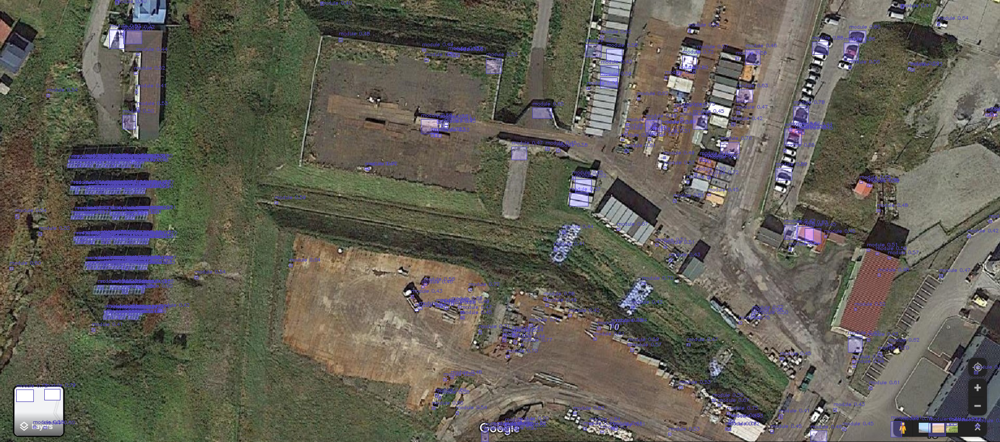

In [23]:
%%time

img = 'data/test/Screenshot 2021-10-06 163117.jpg'
detection_model = MmdetDetectionModel(
    model_path=model_path3,
    config_path=config_file3,
    confidence_threshold=0.4,
    device="cpu", # or 'cuda'
)
result = get_sliced_prediction(
    img,
    detection_model,
    slice_height = 256,
    slice_width = 256,
    overlap_height_ratio = 0.2,
    overlap_width_ratio = 0.2
)
result.export_visuals(export_dir="result/")
Image("result/prediction_visual.png")

## Slicing

In [ ]:
from sahi.slicing import slice_image

slice_image_result = slice_image(
    image=image_path,
    output_file_name=output_file_name,
    output_dir=output_dir,
    slice_height=256,
    slice_width=256,
    overlap_height_ratio=0.2,
    overlap_width_ratio=0.2,
)